<a href="https://colab.research.google.com/github/theadisingh/DS-Major-Project/blob/main/Major_Project_COVID_19.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1. Gathering Data

In [ ]:
#Linking Kaggle API
import os
os.environ['KAGGLE_CONFIG_DIR'] = '/content/drive/My Drive/Data Science Internship/Major Project'

In [74]:
cd /content/drive/My Drive/Data Science Internship/Major Project

/content/drive/My Drive/Data Science Internship/Major Project


In [75]:
#Importing bar chart race
!pip install bar_chart_race

In [ ]:
#Downloading the Dataset
!kaggle datasets download -d sudalairajkumar/covid19-in-india

  0% 0.00/164k [00:00<?, ?B/s]
100% 164k/164k [00:00<00:00, 10.8MB/s]


In [ ]:
#Unziping the file
!unzip covid19-in-india

Archive:  covid19-in-india.zip
  inflating: StatewiseTestingDetails.csv  
  inflating: covid_19_india.csv      


In [ ]:
#Creating DataFrame from the CSV file
import pandas as pd
df = pd.read_csv('/content/drive/My Drive/Data Science Internship/Major Project/StatewiseTestingDetails.csv')
df.head()

,Date,State,TotalSamples,Negative,Positive
0,2020-04-17,Andaman and Nicobar Islands,1403.0,1210,12.0
1,2020-04-24,Andaman and Nicobar Islands,2679.0,NaN,27.0
2,2020-04-27,Andaman and Nicobar Islands,2848.0,NaN,33.0
3,2020-05-01,Andaman and Nicobar Islands,3754.0,NaN,33.0
4,2020-05-16,Andaman and Nicobar Islands,6677.0,NaN,33.0


In [ ]:
#Creating DataFrame from the CSV file
import pandas as pd
df2 = pd.read_csv('/content/drive/My Drive/Data Science Internship/Major Project/covid_19_india.csv')
df2.head()

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed
0,1,30/01/20,6:00 PM,Kerala,1,0,0,0,1
1,2,31/01/20,6:00 PM,Kerala,1,0,0,0,1
2,3,01/02/20,6:00 PM,Kerala,2,0,0,0,2
3,4,02/02/20,6:00 PM,Kerala,3,0,0,0,3
4,5,03/02/20,6:00 PM,Kerala,3,0,0,0,3


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6656 entries, 0 to 6655
Data columns (total 5 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Date          6656 non-null   object 
 1   State         6656 non-null   object 
 2   TotalSamples  6656 non-null   float64
 3   Negative      3737 non-null   object 
 4   Positive      4661 non-null   float64
dtypes: float64(2), object(3)
memory usage: 260.1+ KB


In [ ]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7786 entries, 0 to 7785
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Sno                       7786 non-null   int64 
 1   Date                      7786 non-null   object
 2   Time                      7786 non-null   object
 3   State/UnionTerritory      7786 non-null   object
 4   ConfirmedIndianNational   7786 non-null   object
 5   ConfirmedForeignNational  7786 non-null   object
 6   Cured                     7786 non-null   int64 
 7   Deaths                    7786 non-null   int64 
 8   Confirmed                 7786 non-null   int64 
dtypes: int64(4), object(5)
memory usage: 547.6+ KB


In [ ]:
#Dropping Null Values from Positive Coloumn
df.dropna(subset=['Positive'],inplace=True)

In [ ]:
#Dropping Unassigned Values from Death Counts
df2.drop(df2[df2['State/UnionTerritory']=='Unassigned'].index, inplace=True)
df2.drop(df2[df2['State/UnionTerritory']=='Cases being reassigned to states'].index, inplace=True)

In [ ]:
#Correcting State Spelling Errors
df2.loc[(df2['State/UnionTerritory'] == 'Telangana***') | (df2['State/UnionTerritory'] == 'Telengana') | (df2['State/UnionTerritory'] == 'Telengana***'),'State/UnionTerritory']= 'Telangana' 

In [ ]:
#Creating Date Value Coloumn (DataFrame 1)
df['Day'] = pd.DatetimeIndex(df['Date']).day
df.head()

,Date,State,TotalSamples,Negative,Positive,Day
0,2020-04-17,Andaman and Nicobar Islands,1403.0,1210,12.0,17
1,2020-04-24,Andaman and Nicobar Islands,2679.0,NaN,27.0,24
2,2020-04-27,Andaman and Nicobar Islands,2848.0,NaN,33.0,27
3,2020-05-01,Andaman and Nicobar Islands,3754.0,NaN,33.0,1
4,2020-05-16,Andaman and Nicobar Islands,6677.0,NaN,33.0,16


In [ ]:
#Creating Month Value Coloumn (Dataframe 1)
df['Month'] = pd.DatetimeIndex(df['Date']).month
df.head()

,Date,State,TotalSamples,Negative,Positive,Day,Month
0,2020-04-17,Andaman and Nicobar Islands,1403.0,1210,12.0,17,4
1,2020-04-24,Andaman and Nicobar Islands,2679.0,NaN,27.0,24,4
2,2020-04-27,Andaman and Nicobar Islands,2848.0,NaN,33.0,27,4
3,2020-05-01,Andaman and Nicobar Islands,3754.0,NaN,33.0,1,5
4,2020-05-16,Andaman and Nicobar Islands,6677.0,NaN,33.0,16,5


In [ ]:
#Creating Date Value Coloumn (DataFrame 2)
df2['Day'] = pd.DatetimeIndex(df2['Date']).day
df2.head()

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed,Day
0,1,30/01/20,6:00 PM,Kerala,1,0,0,0,1,30
1,2,31/01/20,6:00 PM,Kerala,1,0,0,0,1,31
2,3,01/02/20,6:00 PM,Kerala,2,0,0,0,2,2
3,4,02/02/20,6:00 PM,Kerala,3,0,0,0,3,2
4,5,03/02/20,6:00 PM,Kerala,3,0,0,0,3,2


In [ ]:
#Creating Month Value Coloumn (DataFrame 2)
df2['Month'] = pd.DatetimeIndex(df2['Date']).month
df2.head()

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed,Day,Month
0,1,30/01/20,6:00 PM,Kerala,1,0,0,0,1,30,1
1,2,31/01/20,6:00 PM,Kerala,1,0,0,0,1,31,1
2,3,01/02/20,6:00 PM,Kerala,2,0,0,0,2,2,1
3,4,02/02/20,6:00 PM,Kerala,3,0,0,0,3,2,2
4,5,03/02/20,6:00 PM,Kerala,3,0,0,0,3,2,3


# 2. Data Analysis

**2.1 Overall Analysis**

In [ ]:
#Total Samples Taken
samSum = df['TotalSamples'].sum()
print(f'The total number of Samples taken are: {samSum}')

The total number of Samples taken are: 2002016320.0


In [ ]:
#Highest Number of Samples taken
df[df['TotalSamples']==df['TotalSamples'].max()]

,Date,State,TotalSamples,Negative,Positive,Day,Month
3847,2020-10-24,Maharashtra,8548036.0,NaN,1638961.0,24,10


In [ ]:
#Lowest Number of Samples taken
df[df['TotalSamples']==df['TotalSamples'].min()]

,Date,State,TotalSamples,Negative,Positive,Day,Month
4153,2020-04-06,Mizoram,58.0,0,1.0,6,4
4154,2020-04-07,Mizoram,58.0,0,1.0,7,4


In [ ]:
#Total Positive Cases
posSum = df['Positive'].sum()
print(f'The total number of positive cases are: {posSum}')

The total number of positive cases are: 179837923.0


In [ ]:
#Highest Affected State
(df.groupby('State', as_index=False)['Positive'].sum()).max()

State       West Bengal
Positive    9.69016e+07
dtype: object

In [ ]:
#Least Affected States
(df.groupby('State', as_index=False)['Positive'].sum()).min()

State       Andaman and Nicobar Islands
Positive                          17644
dtype: object

In [ ]:
#Total Death and Recovered
dedSum = df2['Deaths'].sum()
recSum = df2['Cured'].sum()
print(f'The total number of Deaths are: {dedSum}')
print(f'The total number of Recoveries are: {recSum}')

The total number of Deaths are: 8187696
The total number of Recoveries are: 373475207


In [ ]:
#State with Maximum Death Count
(df2.groupby('State/UnionTerritory',as_index=False)['Deaths'].sum()).max()

State/UnionTerritory    West Bengal
Deaths                      3138377
dtype: object

In [ ]:
#State with least Death Count
(df2.groupby('State/UnionTerritory',as_index=False)['Deaths'].sum()).min()

State/UnionTerritory    Andaman and Nicobar Islands
Deaths                                            0
dtype: object

In [ ]:
#Positive Cases group by States
(df.groupby('State',as_index=False)['Positive'].sum())

,State,Positive
0,Andaman and Nicobar Islands,283708.0
1,Andhra Pradesh,3859260.0
2,Arunachal Pradesh,51245.0
3,Assam,2065991.0
4,Bihar,1859345.0
5,Chandigarh,59195.0
6,Chhattisgarh,467857.0
7,Dadra and Nagar Haveli and Daman and Diu,169010.0
8,Delhi,6848173.0
9,Goa,266181.0


In [ ]:
#Total Death group by States
(df2.groupby('State/UnionTerritory',as_index=False)['Deaths'].sum())

,State/UnionTerritory,Deaths
0,Andaman and Nicobar Islands,3820
1,Andhra Pradesh,420087
2,Arunachal Pradesh,1238
3,Assam,44342
4,Bihar,70787
5,Chandigarh,9796
6,Chhattisgarh,59051
7,Dadar Nagar Haveli,0
8,Dadra and Nagar Haveli and Daman and Diu,210
9,Daman & Diu,0


In [ ]:
#Total Recovered group by States
(df2.groupby('State/UnionTerritory',as_index=False)['Cured'].sum())

,State/UnionTerritory,Cured
0,Andaman and Nicobar Islands,243399
1,Andhra Pradesh,40409530
2,Arunachal Pradesh,463296
3,Assam,10149044
4,Bihar,12246639
5,Chandigarh,555075
6,Chhattisgarh,4856690
7,Dadar Nagar Haveli,14
8,Dadra and Nagar Haveli and Daman and Diu,212004
9,Daman & Diu,0


**2.2 State Wise Analysis**

In [ ]:
#Analysis for a State
statename = input('Enter a state: ')
statedf = df[df['State']==statename]
statedf

Enter a state: Delhi


,Date,State,TotalSamples,Negative,Positive,Day,Month
1504,2020-04-07,Delhi,9041.0,7308,576.0,7,4
1505,2020-04-09,Delhi,9968.0,8643,720.0,9,4
1506,2020-04-10,Delhi,11061.0,9662,903.0,10,4
1507,2020-04-11,Delhi,11709.0,10218,1069.0,11,4
1508,2020-04-12,Delhi,14036.0,11748,1154.0,12,4
...,...,...,...,...,...,...,...
1623,2020-08-07,Delhi,1143703.0,NaN,142723.0,7,8
1624,2020-08-08,Delhi,1168295.0,NaN,144127.0,8,8
1625,2020-08-09,Delhi,1192082.0,NaN,145427.0,9,8
1626,2020-08-10,Delhi,1204405.0,NaN,146134.0,10,8


In [ ]:
statedf_death = df2[df2['State/UnionTerritory']==statename]
statedf_death

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed,Day,Month
34,35,02/03/20,6:00 PM,Delhi,1,0,0,0,1,3,2
38,39,03/03/20,6:00 PM,Delhi,1,0,0,0,1,3,3
42,43,04/03/20,6:00 PM,Delhi,1,0,0,0,1,3,4
45,46,05/03/20,6:00 PM,Delhi,2,0,0,0,2,3,5
51,52,06/03/20,6:00 PM,Delhi,3,0,0,0,3,3,6
...,...,...,...,...,...,...,...,...,...,...,...
7619,7620,23/10/20,8:00 AM,Delhi,-,-,312918,6163,344318,23,10
7654,7655,24/10/20,8:00 AM,Delhi,-,-,316214,6189,348404,24,10
7689,7690,25/10/20,8:00 AM,Delhi,-,-,319828,6225,352520,25,10
7724,7725,26/10/20,8:00 AM,Delhi,-,-,323654,6258,356656,26,10


In [ ]:
#Total Samples taken in the state
statesamSum = statedf['TotalSamples'].sum()
print(f'The total number of samples taken in {statename} are: {statesamSum}')

The total number of samples taken in Delhi are: 50444003.0


In [ ]:
#Total Positive Cases for the state
stateposSum = statedf['Positive'].sum()
print(f'The total number of positive cases in {statename} are: {stateposSum}')

The total number of positive cases in Delhi are: 6848173.0


In [ ]:
#Total Death Toll for the State
statededSum = statedf_death['Deaths'].sum()
print(f'The total number of deaths in {statename} are: {statededSum}')

The total number of deaths in Delhi are: 590548


In [ ]:
#Total Recovered for the State
statecuredSum = statedf_death['Cured'].sum()
print(f'The total number of deaths in {statename} are: {statecuredSum}')

The total number of deaths in Delhi are: 21499809


In [ ]:
#Highest Positive case for the state
statedf[statedf['Positive']==statedf['Positive'].max()]

,Date,State,TotalSamples,Negative,Positive,Day,Month
1631,2020-08-15,Delhi,1291411.0,NaN,151928.0,15,8


In [ ]:
#Lowest Positive case for the state
statedf[statedf['Positive']==statedf['Positive'].min()]

,Date,State,TotalSamples,Negative,Positive,Day,Month
1504,2020-04-07,Delhi,9041.0,7308,576.0,7,4


In [ ]:
#Highest Death case for the state
statedf_death[statedf_death['Deaths']==statedf_death['Deaths'].max()]

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed,Day,Month
7759,7760,27/10/20,8:00 AM,Delhi,-,-,327390,6312,359488,27,10


In [ ]:
#Lowest Death cases for the State
statedf_death[statedf_death['Deaths']==statedf_death['Deaths'].min()]

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed,Day,Month
34,35,02/03/20,6:00 PM,Delhi,1,0,0,0,1,3,2
38,39,03/03/20,6:00 PM,Delhi,1,0,0,0,1,3,3
42,43,04/03/20,6:00 PM,Delhi,1,0,0,0,1,3,4
45,46,05/03/20,6:00 PM,Delhi,2,0,0,0,2,3,5
51,52,06/03/20,6:00 PM,Delhi,3,0,0,0,3,3,6
62,63,07/03/20,6:00 PM,Delhi,3,0,0,0,3,3,7
71,72,08/03/20,6:00 PM,Delhi,3,0,0,0,3,3,8
84,85,09/03/20,6:00 PM,Delhi,4,0,0,0,4,3,9
87,88,10/03/20,6:00 PM,Delhi,4,0,0,0,4,3,10
98,99,11/03/20,6:00 PM,Delhi,5,0,0,0,5,3,11


In [ ]:
#Highest Recovery case for the state
statedf_death[statedf_death['Cured']==statedf_death['Cured'].max()]

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed,Day,Month
7759,7760,27/10/20,8:00 AM,Delhi,-,-,327390,6312,359488,27,10


In [ ]:
#Lowest Recovery case for the state
statedf_death[statedf_death['Cured']==statedf_death['Cured'].min()]

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed,Day,Month
34,35,02/03/20,6:00 PM,Delhi,1,0,0,0,1,3,2
38,39,03/03/20,6:00 PM,Delhi,1,0,0,0,1,3,3
42,43,04/03/20,6:00 PM,Delhi,1,0,0,0,1,3,4
45,46,05/03/20,6:00 PM,Delhi,2,0,0,0,2,3,5
51,52,06/03/20,6:00 PM,Delhi,3,0,0,0,3,3,6
62,63,07/03/20,6:00 PM,Delhi,3,0,0,0,3,3,7
71,72,08/03/20,6:00 PM,Delhi,3,0,0,0,3,3,8
84,85,09/03/20,6:00 PM,Delhi,4,0,0,0,4,3,9
87,88,10/03/20,6:00 PM,Delhi,4,0,0,0,4,3,10
98,99,11/03/20,6:00 PM,Delhi,5,0,0,0,5,3,11


# 3. Visualization

**3.1 Overall Visualization**

In [83]:
#Race Bar Graph
import bar_chart_race as bcr
tempdf2 = df2.set_index('Date')
sorteddf2 = tempdf2.sort_index()
dfPivot = pd.pivot_table(sorteddf2,values = 'Deaths',columns='State/UnionTerritory',index='Date')
bcr.bar_chart_race(df=dfPivot,n_bars=5,filter_column_colors=True,title='COVID 19 Death Cases')

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
INFO:matplotlib.animation:figure size in inches has been adjusted from 8.067708333333332 x 3.5 to 8.055555555555555 x 3.5
INFO:matplotlib.animation:MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 1160x504 -pix_fmt rgba -r 20.0 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y /tmp/tmpr_ror23l/temp.m4v


In [85]:
dfPivot2 = pd.pivot_table(sorteddf2,values = 'Cured',columns='State/UnionTerritory',index='Date')
bcr.bar_chart_race(df=dfPivot2,n_bars=5,filter_column_colors=True,title='COVID 19 Recovered Cases')

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.FFMpegWriter'>
INFO:matplotlib.animation:figure size in inches has been adjusted from 8.067708333333332 x 3.5 to 8.055555555555555 x 3.5
INFO:matplotlib.animation:MovieWriter._run: running command: ffmpeg -f rawvideo -vcodec rawvideo -s 1160x504 -pix_fmt rgba -r 20.0 -loglevel error -i pipe: -vcodec h264 -pix_fmt yuv420p -y /tmp/tmpop3b5gk9/temp.m4v


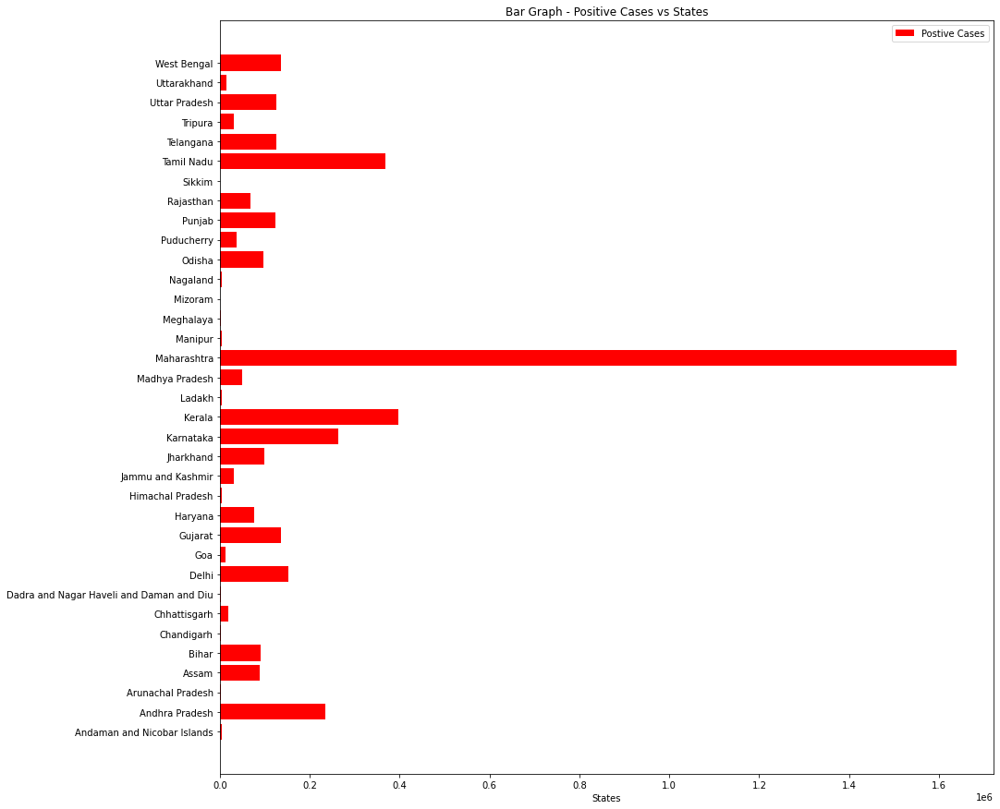

In [ ]:
#Plotting Postive Cases State Wise
import numpy as np
import matplotlib.pyplot as plt
plt.figure(figsize=(15,15))
plt.barh(df['State'],df['Positive'],color='red')
plt.title('Bar Graph - Positive Cases vs States')
plt.xlabel('States')
plt.legend(['Postive Cases'])  
plt.show()

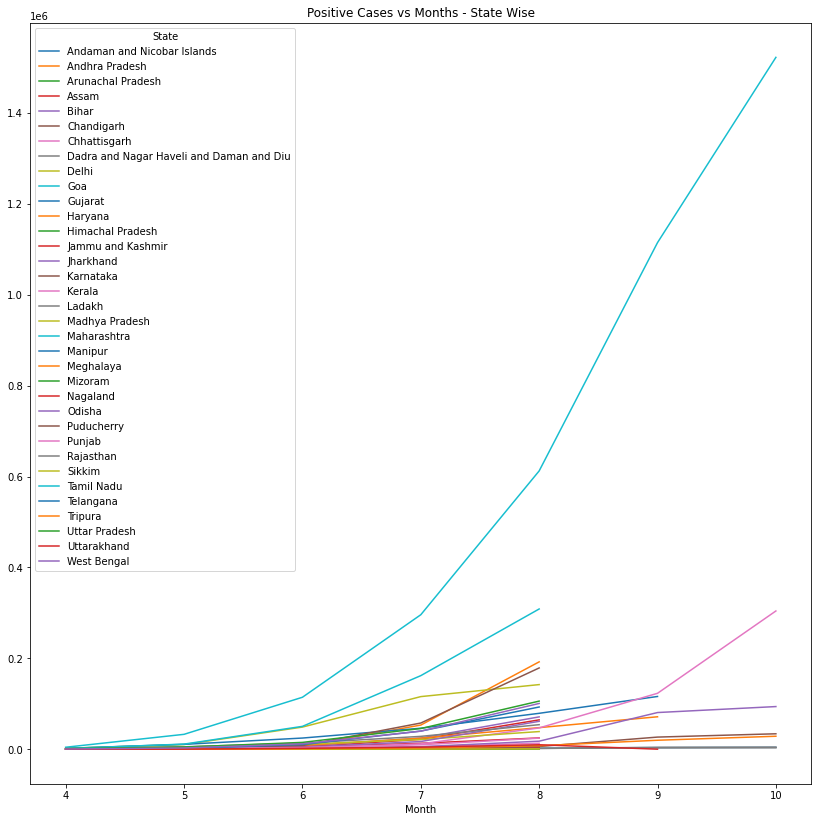

In [86]:
#Creating a table using Pivot Table & Plotting
dfPivot = pd.pivot_table(df,values = 'Positive',columns='State',index='Month')
dfPivot.plot(figsize=(14,14),title='Positive Cases vs Months - State Wise')

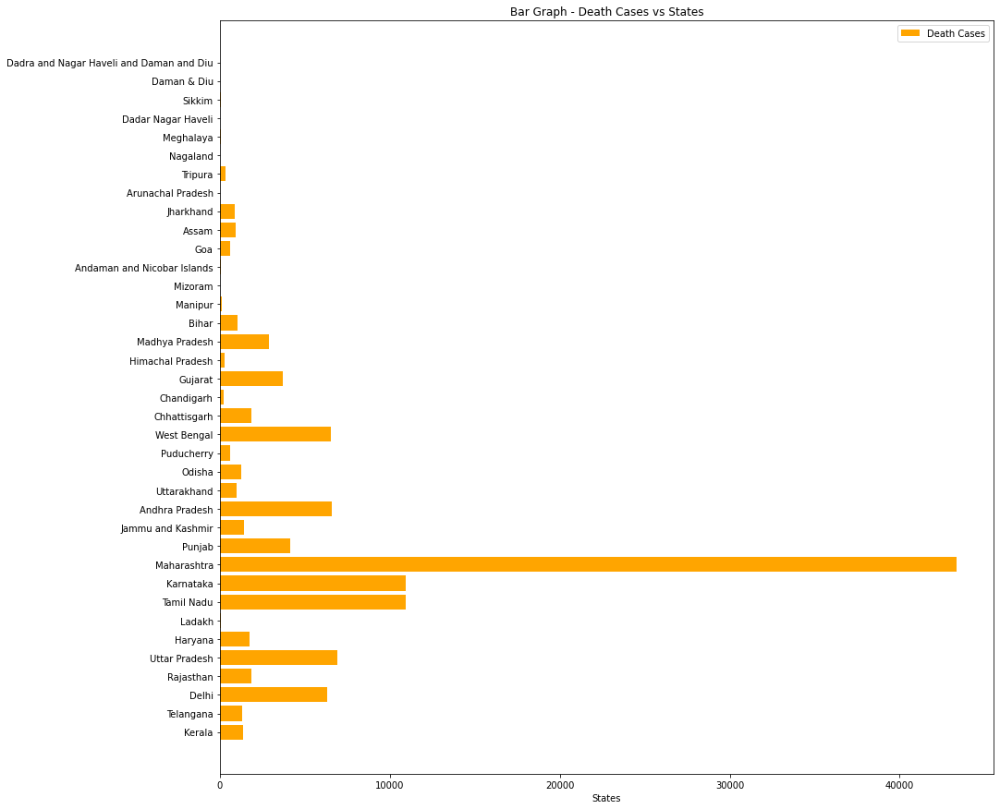

In [ ]:
#Plotting Death Cases State Wise
plt.figure(figsize=(15,15))
plt.barh(df2['State/UnionTerritory'],df2['Deaths'],color='orange')
plt.title('Bar Graph - Death Cases vs States')
plt.xlabel('States')
plt.legend(['Death Cases'])  
plt.show()

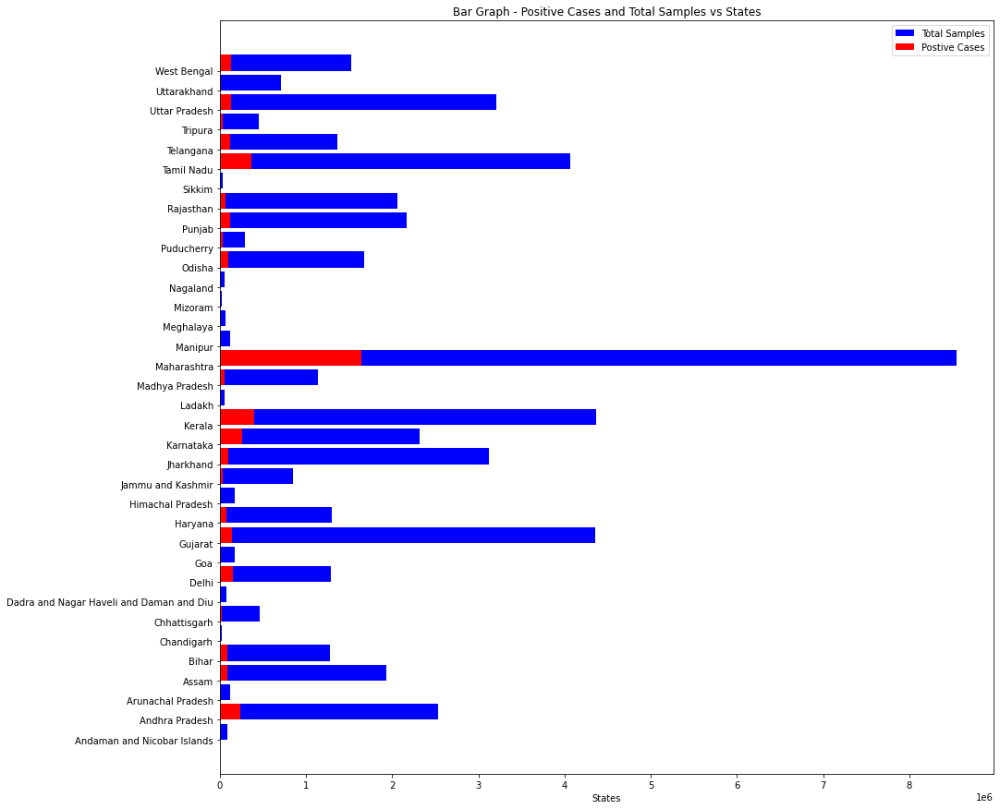

In [ ]:
#Plotting Postive Cases & Total Samples - State Wise
plt.figure(figsize=(15,15))
plt.barh(df['State'],df['TotalSamples'],color = 'blue',align='edge')
plt.barh(df['State'],df['Positive'],color = 'red',align = 'edge')
plt.title('Bar Graph - Positive Cases and Total Samples vs States')
plt.xlabel('States')
plt.legend(['Total Samples','Postive Cases'])  
plt.show()

State
Andaman and Nicobar Islands                   1719.442424
Andhra Pradesh                               31376.097561
Arunachal Pradesh                              441.767241
Assam                                        18122.728070
Bihar                                        14756.706349
Chandigarh                                     466.102362
Chhattisgarh                                  3713.150794
Dadra and Nagar Haveli and Daman and Diu      1119.271523
Delhi                                        55676.203252
Goa                                           2129.448000
Gujarat                                      46839.280702
Haryana                                      17381.061224
Himachal Pradesh                               933.546875
Jammu and Kashmir                             7578.410853
Jharkhand                                    20825.365385
Karnataka                                    35887.000000
Kerala                                       64747.794258
Ladakh  

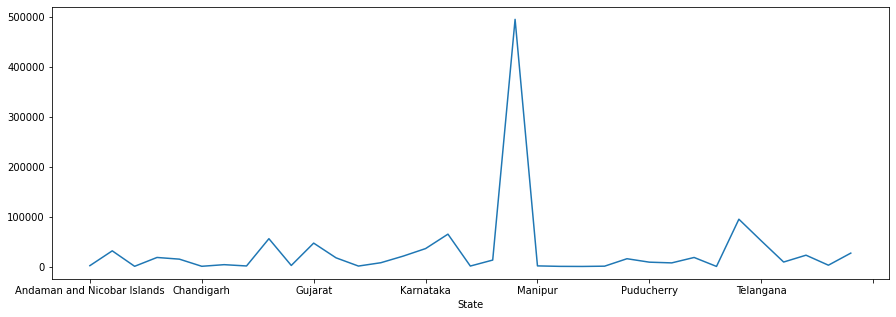

In [ ]:
#Mean Positive Cases per State
print(df.groupby('State')['Positive'].mean())
df.groupby('State')['Positive'].mean().plot(figsize=(15,5))

State/UnionTerritory
Andaman and Nicobar Islands                    17.685185
Andhra Pradesh                               1826.465217
Arunachal Pradesh                               5.951923
Assam                                         211.152381
Bihar                                         321.759091
Chandigarh                                     43.928251
Chhattisgarh                                  264.802691
Dadar Nagar Haveli                              0.000000
Dadra and Nagar Haveli and Daman and Diu        1.521739
Daman & Diu                                     0.000000
Delhi                                        2460.616667
Goa                                           124.467593
Gujarat                                      1843.500000
Haryana                                       435.399160
Himachal Pradesh                               49.809955
Jammu and Kashmir                             382.785408
Jharkhand                                     227.261905
Karnataka 

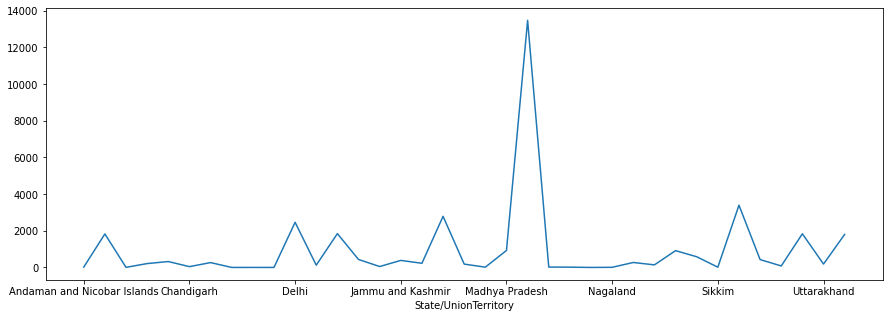

In [ ]:
#Mean Death Cases per State
print(df2.groupby('State/UnionTerritory')['Deaths'].mean())
df2.groupby('State/UnionTerritory')['Deaths'].mean().plot(figsize=(15,5))

State/UnionTerritory
Andaman and Nicobar Islands                   1126.847222
Andhra Pradesh                              175693.608696
Arunachal Pradesh                             2227.384615
Assam                                        48328.780952
Bihar                                        55666.540909
Chandigarh                                    2489.125561
Chhattisgarh                                 21778.878924
Dadar Nagar Haveli                               0.378378
Dadra and Nagar Haveli and Daman and Diu      1536.260870
Daman & Diu                                      0.000000
Delhi                                        89582.537500
Goa                                           8479.620370
Gujarat                                      45198.108108
Haryana                                      32839.621849
Himachal Pradesh                              3318.312217
Jammu and Kashmir                            17481.206009
Jharkhand                                    20373.

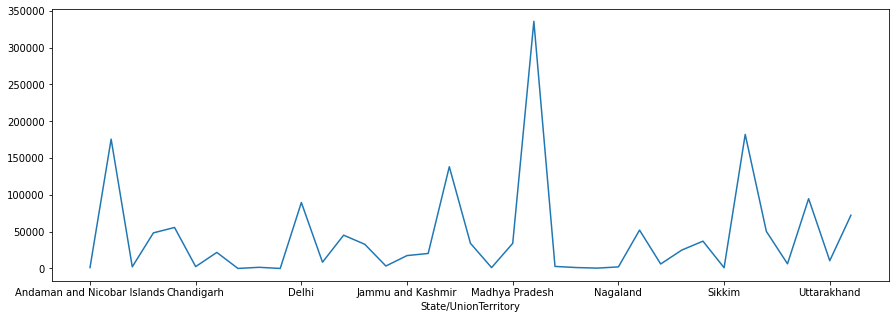

In [ ]:
#Mean Recovery Cases per State
print(df2.groupby('State/UnionTerritory')['Cured'].mean())
df2.groupby('State/UnionTerritory')['Cured'].mean().plot(figsize=(15,5))

**3.2 State Wise Visualization**

In [ ]:
#Getting Details for a state
statename2 = input('Enter State Name: ')
statedf2 = df.loc[df['State']==statename2]
state_deathdf2 = df2.loc[df2['State/UnionTerritory']==statename2]
statemonth = int(input('Please enter month for day wise trend(4 to 10): '))
statemonthdf = statedf2.loc[statedf2['Month']==statemonth]
statemonth_deathdf = state_deathdf2.loc[state_deathdf2['Month']==statemonth]

Enter State Name: Delhi
Please enter month for day wise trend(4 to 10): 5


       TotalSamples
Month              
4          539303.0
5         3921639.0
6         9972589.0
7        23518869.0
8        12491603.0


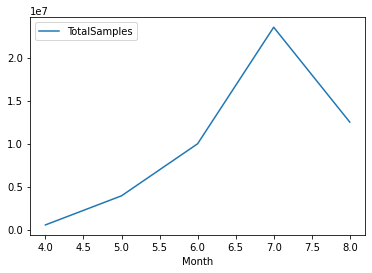

In [ ]:
#Month wise trend of total samples for a state
print((statedf2.groupby('Month')['TotalSamples'].sum()).to_frame())
(statedf2.groupby('Month')['TotalSamples'].sum()).to_frame().plot()

     TotalSamples
Day              
2         58210.0
3         60246.0
4         64108.0
5         67852.0
6         71934.0
7         77234.0
8         81367.0
9         84226.0
10        93810.0
11        97678.0
12       106109.0
13       113345.0
14       119736.0
15       125189.0
16       130845.0
17       135791.0
18       139727.0
19       145854.0
20       150282.0
21       154385.0
22       160255.0
23       165047.0
24       169873.0
25       174469.0
26       178579.0
27       184362.0
28       191977.0
29       199626.0
30       206739.0
31       212784.0


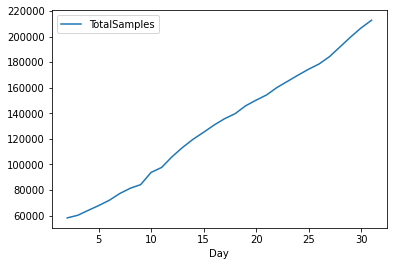

In [ ]:
#Day wise trend of Total Samples for a state
print((statemonthdf.groupby('Day')['TotalSamples'].sum()).to_frame())
(statemonthdf.groupby('Day')['TotalSamples'].sum()).to_frame().plot()

        Positive
Month           
4        43092.0
5       307128.0
6      1460911.0
7      3472909.0
8      1564133.0


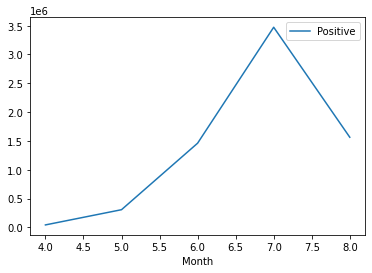

In [ ]:
#Month wise trend of positive cases for a state
print((statedf2.groupby('Month')['Positive'].sum()).to_frame())
(statedf2.groupby('Month')['Positive'].sum()).to_frame().plot()

     Positive
Day          
2      4122.0
3      4549.0
4      4898.0
5      5104.0
6      5532.0
7      5980.0
8      6318.0
9      6542.0
10     6923.0
11     7233.0
12     7639.0
13     7998.0
14     8470.0
15     8895.0
16     9333.0
17     9755.0
18    10054.0
19    10554.0
20    11088.0
21    11659.0
22    12319.0
23    12910.0
24    13418.0
25    14053.0
26    14465.0
27    15257.0
28    16281.0
29    17386.0
30    18549.0
31    19844.0


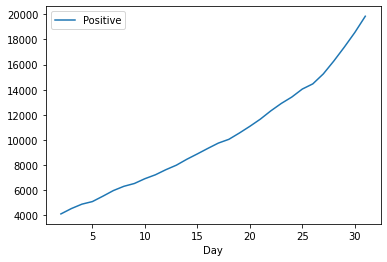

In [ ]:
#Day wise trend of positive cases for a state
print((statemonthdf.groupby('Day')['Positive'].sum()).to_frame())
(statemonthdf.groupby('Day')['Positive'].sum()).to_frame().plot()

       Deaths
Month        
1       17044
2       17243
3       17432
4       18391
5       21903
6       54895
7       88015
8       99544
9      108560
10     109507
11      18908
12      19106


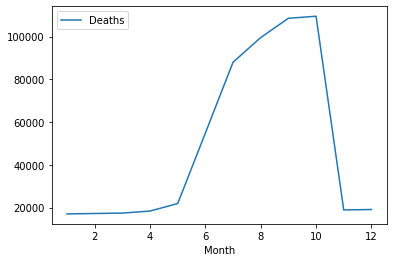

In [ ]:
#Month wise trend of deaths for a state
print((state_deathdf2.groupby('Month')['Deaths'].sum()).to_frame())
(state_deathdf2.groupby('Month')['Deaths'].sum()).to_frame().plot()

     Deaths
Day        
3         0
4         7
5        64
6       650
7      3004
8      4033
9      4513
10     5510
13       86
14      106
15      115
16      123
17      129
18      160
19      168
20      168
21      176
22      194
23      208
24      231
25      261
26      276
27      288
28      303
29      316
30      398
31      416


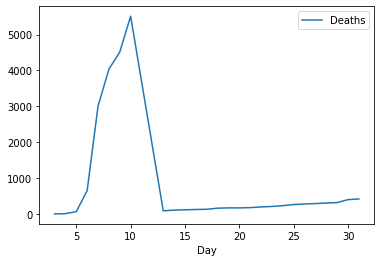

In [ ]:
#Day wise trend of Deaths for a state
print((statemonth_deathdf.groupby('Day')['Deaths'].sum()).to_frame())
(statemonth_deathdf.groupby('Day')['Deaths'].sum()).to_frame().plot()

         Cured
Month         
1       591980
2       599385
3       609281
4       626973
5       730760
6      1208098
7      2654825
8      3374993
9      4476356
10     5247272
11      684902
12      694984


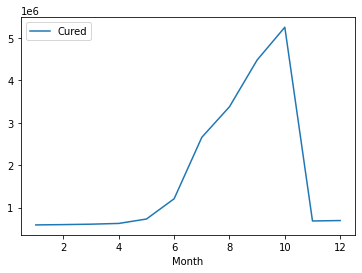

In [ ]:
#Month wise trend of Recovered for a state
print((state_deathdf2.groupby('Month')['Cured'].sum()).to_frame())
(state_deathdf2.groupby('Month')['Cured'].sum()).to_frame().plot()

      Cured
Day        
3         0
4        18
5      1431
6      9898
7     68256
8    125226
9    161865
10   260350
13     2512
14     2858
15     3045
16     3518
17     3926
18     4485
19     4485
20     4750
21     5192
22     5567
23     5897
24     6267
25     6540
26     6771
27     7223
28     7264
29     7495
30     7846
31     8075


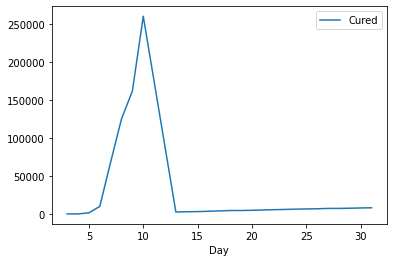

In [ ]:
#Day wise trend of Recovered cases for a state
print((statemonth_deathdf.groupby('Day')['Cured'].sum()).to_frame())
(statemonth_deathdf.groupby('Day')['Cured'].sum()).to_frame().plot()

# 4. Forecasting

In [ ]:
#Predictions for particular state
statename3 = input('Enter the state name: ')
statedf3 = df.loc[df['State']==statename3]
state_deathdf3 = df2.loc[df2['State/UnionTerritory']==statename3]

Enter the state name: Delhi


In [ ]:
statedf3

,Date,State,TotalSamples,Negative,Positive,Day,Month
1504,2020-04-07,Delhi,9041.0,7308,576.0,7,4
1505,2020-04-09,Delhi,9968.0,8643,720.0,9,4
1506,2020-04-10,Delhi,11061.0,9662,903.0,10,4
1507,2020-04-11,Delhi,11709.0,10218,1069.0,11,4
1508,2020-04-12,Delhi,14036.0,11748,1154.0,12,4
...,...,...,...,...,...,...,...
1623,2020-08-07,Delhi,1143703.0,NaN,142723.0,7,8
1624,2020-08-08,Delhi,1168295.0,NaN,144127.0,8,8
1625,2020-08-09,Delhi,1192082.0,NaN,145427.0,9,8
1626,2020-08-10,Delhi,1204405.0,NaN,146134.0,10,8


In [ ]:
state_deathdf3

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed,Day,Month
34,35,02/03/20,6:00 PM,Delhi,1,0,0,0,1,3,2
38,39,03/03/20,6:00 PM,Delhi,1,0,0,0,1,3,3
42,43,04/03/20,6:00 PM,Delhi,1,0,0,0,1,3,4
45,46,05/03/20,6:00 PM,Delhi,2,0,0,0,2,3,5
51,52,06/03/20,6:00 PM,Delhi,3,0,0,0,3,3,6
...,...,...,...,...,...,...,...,...,...,...,...
7619,7620,23/10/20,8:00 AM,Delhi,-,-,312918,6163,344318,23,10
7654,7655,24/10/20,8:00 AM,Delhi,-,-,316214,6189,348404,24,10
7689,7690,25/10/20,8:00 AM,Delhi,-,-,319828,6225,352520,25,10
7724,7725,26/10/20,8:00 AM,Delhi,-,-,323654,6258,356656,26,10


In [ ]:
#Chaning Positive cases to integer value
statedf3['Positive'] = statedf3['Positive'].astype(int)
statedf3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 123 entries, 1504 to 1631
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Date          123 non-null    object 
 1   State         123 non-null    object 
 2   TotalSamples  123 non-null    float64
 3   Negative      22 non-null     object 
 4   Positive      123 non-null    int64  
 5   Day           123 non-null    int64  
 6   Month         123 non-null    int64  
dtypes: float64(1), int64(3), object(3)
memory usage: 7.7+ KB


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
#Chaniging date to datetime format (DataFrame 1)
statedf3['Date'] = pd.to_datetime(statedf3['Date'])
statedf3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 123 entries, 1504 to 1631
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Date          123 non-null    datetime64[ns]
 1   State         123 non-null    object        
 2   TotalSamples  123 non-null    float64       
 3   Negative      22 non-null     object        
 4   Positive      123 non-null    int64         
 5   Day           123 non-null    int64         
 6   Month         123 non-null    int64         
dtypes: datetime64[ns](1), float64(1), int64(3), object(2)
memory usage: 7.7+ KB


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
#Chaniging date to datetime format (DataFrame 2)
state_deathdf3['Date'] = pd.to_datetime(state_deathdf3['Date'])
state_deathdf3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 240 entries, 34 to 7759
Data columns (total 11 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   Sno                       240 non-null    int64         
 1   Date                      240 non-null    datetime64[ns]
 2   Time                      240 non-null    object        
 3   State/UnionTerritory      240 non-null    object        
 4   ConfirmedIndianNational   240 non-null    object        
 5   ConfirmedForeignNational  240 non-null    object        
 6   Cured                     240 non-null    int64         
 7   Deaths                    240 non-null    int64         
 8   Confirmed                 240 non-null    int64         
 9   Day                       240 non-null    int64         
 10  Month                     240 non-null    int64         
dtypes: datetime64[ns](1), int64(6), object(4)
memory usage: 22.5+ KB


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [ ]:
#Creating new DataFrame 1 with only Date and Positive cases value & Changing coloumn names to ds and y
new_statedf3 = statedf3[['Date','Positive']]
new_statedf3 = new_statedf3.rename(columns={'Date':'ds','Positive':'y'})
new_statedf3

,ds,y
1504,2020-04-07,576
1505,2020-04-09,720
1506,2020-04-10,903
1507,2020-04-11,1069
1508,2020-04-12,1154
...,...,...
1623,2020-08-07,142723
1624,2020-08-08,144127
1625,2020-08-09,145427
1626,2020-08-10,146134


In [ ]:
#Creating new DataFrame 2 with only Date and Death cases value & Changing coloumn names to ds and y
new_state_deathdf3 = state_deathdf3[['Date','Deaths']]
new_state_deathdf3 = new_state_deathdf3.rename(columns={'Date':'ds','Deaths':'y'})
new_state_deathdf3

,ds,y
34,2020-02-03,0
38,2020-03-03,0
42,2020-04-03,0
45,2020-05-03,0
51,2020-06-03,0
...,...,...
7619,2020-10-23,6163
7654,2020-10-24,6189
7689,2020-10-25,6225
7724,2020-10-26,6258


In [ ]:
#Creating new DataFrame 3 with only Date and Cured cases value & Changing coloumn names to ds and y
new_state_deathdf4 = state_deathdf3[['Date','Cured']]
new_state_deathdf4 = new_state_deathdf4.rename(columns={'Date':'ds','Cured':'y'})
new_state_deathdf4

,ds,y
34,2020-02-03,0
38,2020-03-03,0
42,2020-04-03,0
45,2020-05-03,0
51,2020-06-03,0
...,...,...
7619,2020-10-23,312918
7654,2020-10-24,316214
7689,2020-10-25,319828
7724,2020-10-26,323654


In [ ]:
#Forcasting for Active Cases
import fbprophet
fb = fbprophet.Prophet(changepoint_prior_scale=0.5)
fb.add_seasonality(name='Monthly',period=30,fourier_order=6) 
fb.fit(new_statedf3)

# Make future possible prediction
forecast = fb.make_future_dataframe(periods = 30,freq = 'd')
forecast = fb.predict(forecast)
forecast

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,Monthly,Monthly_lower,Monthly_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2020-04-07,1338.984334,416.679818,720.146133,1338.984334,1338.984334,-592.242388,-592.242388,-592.242388,-779.756379,-779.756379,-779.756379,-187.513991,-187.513991,-187.513991,0.0,0.0,0.0,559.227955
1,2020-04-09,1318.336555,515.939843,809.464353,1318.336555,1318.336555,-647.483575,-647.483575,-647.483575,-657.351402,-657.351402,-657.351402,-9.867827,-9.867827,-9.867827,0.0,0.0,0.0,660.985153
2,2020-04-10,1308.012666,798.292673,1129.955221,1308.012666,1308.012666,-475.426099,-475.426099,-475.426099,-340.884592,-340.884592,-340.884592,134.541507,134.541507,134.541507,0.0,0.0,0.0,967.128074
3,2020-04-11,1297.688776,1027.180055,1351.859016,1297.688776,1297.688776,-283.468003,-283.468003,-283.468003,-117.150877,-117.150877,-117.150877,166.317126,166.317126,166.317126,0.0,0.0,0.0,1180.537900
4,2020-04-12,1287.364887,1163.190410,1467.629563,1287.364887,1287.364887,-131.806552,-131.806552,-131.806552,27.134437,27.134437,27.134437,158.940989,158.940989,158.940989,0.0,0.0,0.0,1314.499324
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
148,2020-09-10,180685.527272,165477.832379,197653.847813,165533.421414,197586.930864,-35.219669,-35.219669,-35.219669,-45.087496,-45.087496,-45.087496,-9.867827,-9.867827,-9.867827,0.0,0.0,0.0,180640.439776
149,2020-09-11,181786.772442,165802.596865,200094.074525,165597.850859,199984.832118,-14.287870,-14.287870,-14.287870,120.253636,120.253636,120.253636,134.541507,134.541507,134.541507,0.0,0.0,0.0,181907.026078
150,2020-09-12,182888.017612,165715.236572,202275.812628,165684.039254,202370.119864,-93.721758,-93.721758,-93.721758,72.595368,72.595368,72.595368,166.317126,166.317126,166.317126,0.0,0.0,0.0,182960.612980
151,2020-09-13,183989.262782,165367.039911,204276.518326,165419.677936,204426.116894,-233.342231,-233.342231,-233.342231,-74.401242,-74.401242,-74.401242,158.940989,158.940989,158.940989,0.0,0.0,0.0,183914.861540


In [ ]:
forecast[['ds','yhat','yhat_lower','yhat_upper']]

,ds,yhat,yhat_lower,yhat_upper
0,2020-04-07,559.227955,416.679818,720.146133
1,2020-04-09,660.985153,515.939843,809.464353
2,2020-04-10,967.128074,798.292673,1129.955221
3,2020-04-11,1180.537900,1027.180055,1351.859016
4,2020-04-12,1314.499324,1163.190410,1467.629563
...,...,...,...,...
148,2020-09-10,180640.439776,165477.832379,197653.847813
149,2020-09-11,181907.026078,165802.596865,200094.074525
150,2020-09-12,182960.612980,165715.236572,202275.812628
151,2020-09-13,183914.861540,165367.039911,204276.518326


Text(0.5, 1.0, 'Forecasting Active Cases')

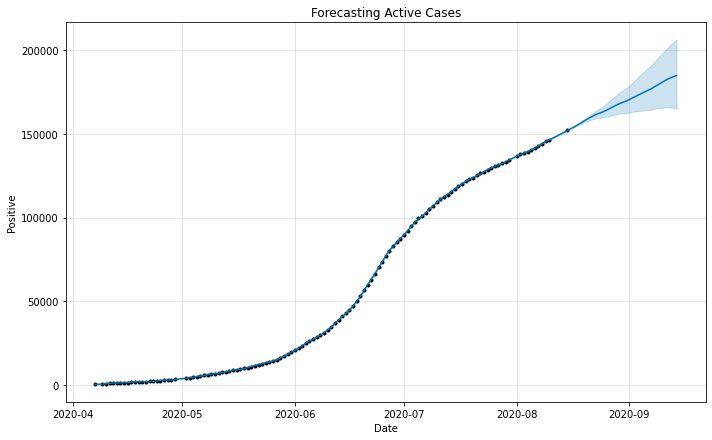

In [ ]:
#Plotting Forecast
fb.plot(forecast,xlabel='Date',ylabel='Positive')
plt.title('Forecasting Active Cases')

In [ ]:
#Forcasting for Death Cases
fb = fbprophet.Prophet(changepoint_prior_scale=0.5)
fb.add_seasonality(name='Monthly',period=30,fourier_order=6) 
fb.fit(new_state_deathdf3)

# Make future possible prediction
forecast = fb.make_future_dataframe(periods = 30,freq = 'd')
forecast = fb.predict(forecast)
forecast

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,Monthly,Monthly_lower,Monthly_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2020-01-04,3419.472607,352.682013,4210.383943,3419.472607,3419.472607,-970.370263,-970.370263,-970.370263,-1180.617293,-1180.617293,-1180.617293,-210.247030,-210.247030,-210.247030,0.0,0.0,0.0,2238.855314
1,2020-01-05,3389.523107,-399.944364,3573.570752,3389.523107,3389.523107,-1702.570818,-1702.570818,-1702.570818,-1764.148247,-1764.148247,-1764.148247,-61.577429,-61.577429,-61.577429,0.0,0.0,0.0,1625.374860
2,2020-01-06,3359.573607,-644.448289,3349.323406,3359.573607,3359.573607,-1994.367411,-1994.367411,-1994.367411,-1969.803880,-1969.803880,-1969.803880,24.563531,24.563531,24.563531,0.0,0.0,0.0,1389.769728
3,2020-01-07,3329.624108,-365.404741,3736.966036,3329.624108,3329.624108,-1722.418269,-1722.418269,-1722.418269,-1596.478558,-1596.478558,-1596.478558,125.939711,125.939711,125.939711,0.0,0.0,0.0,1733.145550
4,2020-01-08,3299.674608,493.790700,4493.133957,3299.674608,3299.674608,-1030.630275,-1030.630275,-1030.630275,-931.444293,-931.444293,-931.444293,99.185981,99.185981,99.185981,0.0,0.0,0.0,2368.230315
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
265,2021-01-05,2398.305044,1655.096055,5640.764358,2279.861982,2529.051683,1088.515111,1088.515111,1088.515111,1214.454822,1214.454822,1214.454822,125.939711,125.939711,125.939711,0.0,0.0,0.0,3612.759866
266,2021-01-06,2380.488803,1668.580968,5573.340700,2254.047365,2521.408388,1186.847486,1186.847486,1186.847486,1286.033467,1286.033467,1286.033467,99.185981,99.185981,99.185981,0.0,0.0,0.0,3666.522270
267,2021-01-07,2362.672562,1238.874751,5225.198917,2228.047915,2510.190913,909.244803,909.244803,909.244803,919.256604,919.256604,919.256604,10.011801,10.011801,10.011801,0.0,0.0,0.0,3281.929165
268,2021-01-08,2344.856321,853.899633,4899.738402,2201.285599,2500.389348,451.974388,451.974388,451.974388,464.097822,464.097822,464.097822,12.123435,12.123435,12.123435,0.0,0.0,0.0,2808.954143


In [ ]:
forecast[['ds','yhat','yhat_lower','yhat_upper']]

,ds,yhat,yhat_lower,yhat_upper
0,2020-01-04,2238.855314,352.682013,4210.383943
1,2020-01-05,1625.374860,-399.944364,3573.570752
2,2020-01-06,1389.769728,-644.448289,3349.323406
3,2020-01-07,1733.145550,-365.404741,3736.966036
4,2020-01-08,2368.230315,493.790700,4493.133957
...,...,...,...,...
265,2021-01-05,3612.759866,1655.096055,5640.764358
266,2021-01-06,3666.522270,1668.580968,5573.340700
267,2021-01-07,3281.929165,1238.874751,5225.198917
268,2021-01-08,2808.954143,853.899633,4899.738402


Text(0.5, 1.0, 'Forecasting Death Cases')

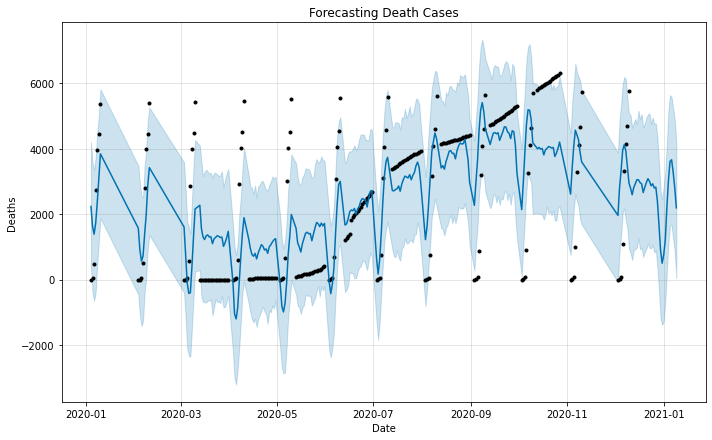

In [ ]:
#Plotting Forecast
fb.plot(forecast,xlabel='Date',ylabel='Deaths')
plt.title('Forecasting Death Cases')

In [ ]:
#Forcasting for Cured Cases
import fbprophet
fb = fbprophet.Prophet(changepoint_prior_scale=0.5)
fb.add_seasonality(name='Monthly',period=30,fourier_order=6) 
fb.fit(new_state_deathdf4)

# Make future possible prediction
forecast = fb.make_future_dataframe(periods = 30,freq = 'd')
forecast = fb.predict(forecast)
forecast

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,Monthly,Monthly_lower,Monthly_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2020-01-04,124559.724054,-6176.565709,176153.993762,124559.724054,124559.724054,-30799.707979,-30799.707979,-30799.707979,-40430.493134,-40430.493134,-40430.493134,-9630.785155,-9630.785155,-9630.785155,0.0,0.0,0.0,84129.230920
1,2020-01-05,123467.864051,-19308.053281,161857.591570,123467.864051,123467.864051,-54614.183490,-54614.183490,-54614.183490,-57903.199955,-57903.199955,-57903.199955,-3289.016465,-3289.016465,-3289.016465,0.0,0.0,0.0,65564.664096
2,2020-01-06,122376.004049,-37550.627760,139851.402486,122376.004049,122376.004049,-71734.307293,-71734.307293,-71734.307293,-71380.118623,-71380.118623,-71380.118623,354.188670,354.188670,354.188670,0.0,0.0,0.0,50995.885425
3,2020-01-07,121284.144046,-37839.277900,143640.973329,121284.144046,121284.144046,-73964.767611,-73964.767611,-73964.767611,-69348.237571,-69348.237571,-69348.237571,4616.530040,4616.530040,4616.530040,0.0,0.0,0.0,51935.906475
4,2020-01-08,120192.284043,-25038.838421,160257.057727,120192.284043,120192.284043,-56407.217107,-56407.217107,-56407.217107,-52386.291555,-52386.291555,-52386.291555,4020.925552,4020.925552,4020.925552,0.0,0.0,0.0,67805.992488
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
265,2021-01-05,127947.639328,81992.216415,265523.949134,122832.132299,133495.570633,35764.768032,35764.768032,35764.768032,40381.298072,40381.298072,40381.298072,4616.530040,4616.530040,4616.530040,0.0,0.0,0.0,168328.937400
266,2021-01-06,127495.341294,77822.024138,259609.102161,122001.663378,133400.203091,40144.040120,40144.040120,40144.040120,44164.965672,44164.965672,44164.965672,4020.925552,4020.925552,4020.925552,0.0,0.0,0.0,171660.306966
267,2021-01-07,127043.043260,68541.262965,251182.708513,121119.494474,133350.133208,30675.107275,30675.107275,30675.107275,31634.056595,31634.056595,31634.056595,958.949320,958.949320,958.949320,0.0,0.0,0.0,158677.099855
268,2021-01-08,126590.745227,58227.805835,237049.367533,120392.069306,133318.407745,17493.072110,17493.072110,17493.072110,20462.280148,20462.280148,20462.280148,2969.208038,2969.208038,2969.208038,0.0,0.0,0.0,147053.025375


In [ ]:
forecast[['ds','yhat','yhat_lower','yhat_upper']]

,ds,yhat,yhat_lower,yhat_upper
0,2020-01-04,84129.230920,-6176.565709,176153.993762
1,2020-01-05,65564.664096,-19308.053281,161857.591570
2,2020-01-06,50995.885425,-37550.627760,139851.402486
3,2020-01-07,51935.906475,-37839.277900,143640.973329
4,2020-01-08,67805.992488,-25038.838421,160257.057727
...,...,...,...,...
265,2021-01-05,168328.937400,81992.216415,265523.949134
266,2021-01-06,171660.306966,77822.024138,259609.102161
267,2021-01-07,158677.099855,68541.262965,251182.708513
268,2021-01-08,147053.025375,58227.805835,237049.367533


Text(0.5, 1.0, 'Forecasting Recovery Cases')

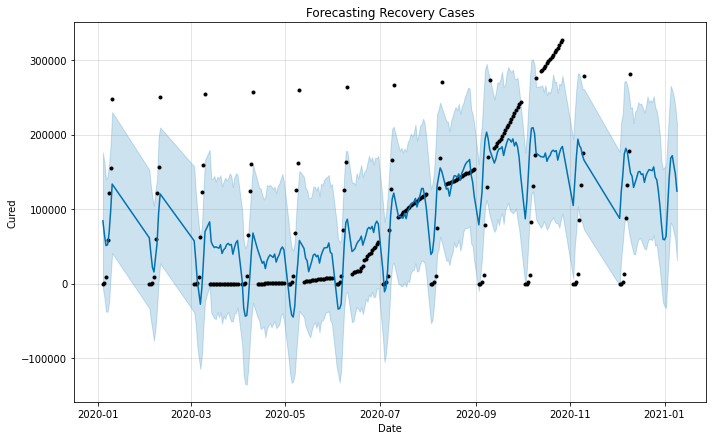

In [ ]:
#Plotting Forecast
fb.plot(forecast,xlabel='Date',ylabel='Cured')
plt.title('Forecasting Recovery Cases')